<p><img style="padding: 0 15px; float: left;" src="FTLogo300.jpg" alt="FT Crusader Logo" Width='140' Height= '250'/></p> 
<p> <h2> 311 Blocked Bike Lane Requests Exploratory Analysis 12/06/24</h2>
<p> <h3> By Abu Nayeem (anayeem1@gmail.com) 

[Sustainabu GitHub Link](https://github.com/sustainabu/OpenDataNYC)

# Table of contents <a name="content"></a>
* [Purpose](#d0)
* [About the Data](#d1)
* [Descriptive Statistics](#d2)
  * [Borough Service Overview](#d2a)
  * [Borough Community Board Overview](#d3)
  * [Top Frequent Requested Areas](#d4)
  * [Temporal Analysis](#d5)
* [NYPD Response Breakdown](#d6)
  *  [NYPD Response Breakdown by Borough](#d7)
* [NYPD Response Time Breakdown (Unbinned)](#d8)
  *  [NYPD Response Time Breakdown (binned)](#d9)
  * [NYPD Response Time Breakdown by Borough (binned)](#d10)
  * [NYPD Response Time Breakdown by Resolution (binned)](#d11)
* [Geo-Spatial Analysis](#d13)
  *  [Community Board Density Map (Interactive)](#d14)
  * [NYPD Response Bubble Map (Interactive)](#d15)
  * [NYPD Median Response TIME Bubble Map (Interactive)](#d16)
  * [311 Blocked Bike Lane Data Dashboard](#d17)
* [Conclusion](#d18)
* [Next Steps](#d19)
* [Run Code](#d20)

# Purpose <a name="d0"></a>

I’m a Queens native, and a cyclist. I’m greatly appreciative of the existing bike infrastructure in Queens, but the frequency of obstruction and lack of enforcement within bike lanes are frustrating and life-threatening. It should not be the case that cyclists are risking their life when riding their bike even with dedicated lanes. NYC has a 311 reporting system to report violations, which the NYPD enforces. 

kRr, recent studies have shown the NYPD are doing an inadequate job w[ith only 2% of service requests receiving summons compared to 16% of other similar compla](https://nyc.streetsblog.org/2023/04/06/nypd-tickets-fewer-than-2-of-blocked-bike-lane-complaints-analysis)ints. In 2021, Streetblogs did[ an investigative re](https://nyc.streetsblog.org/2021/10/21/ignored-dismissed-how-the-nypd-neglects-311-complaints-about-driver-misconduct)port highlighting the sharp increase of NYPD unrealistic response time of less than five minutes as shown in the graph below. Finally, in 2024, there wa[s a surveillance s](https://nyc.streetsblog.org/2024/10/29/study-exposes-nypds-systemic-failure-to-enforce-safety-related-parking-violations)tudy using AI to empirically verify the lack of police enforcement, and false reporting in the service 311 recor

![Fig0.1](Screenshots/Fig0.png)ds. 

This exploratory report reviews 311 service request data for Blocked Bike Lane violations within the last tw (starting January, 1st, 2023) years to provide baselight insight, highlight inequities, and provide the tools for community members to take action. I’ve cren **[INTERACTIVEa data das](https://sustainabu.shinyapps.io/blockedbikelanedashboard/)**hboard to monitor progress and hold local enforcement. I provide some recommendations at the end to address this issue, including my interest to build a civic-tech app that crowds-source validation to increase transparency and hold NYPD accountable.


**Why does adequate enforcement of blocked bike lanes incidents matter?**
* Unlike vehicle-drivers, cyclists can face severe bodily harm if there is a vehicle collison. Obstruction can force cyclists to veer into a vehicle lane. Vehicle drivers may not be paying attention and/or willful negligence.
* Unsafe bike trips lead to less ridership
* Lack of enforcement encourage violators
* Misallocations of public funds [i.e. invest in infrastructure without basic safety

**How does NYPD prioritize blocked bike lanes requests?**
* These are low-priority requests, but it's still required for NYPD to review them. Within a police precinct, the increased frequency of higher-priority crimes and traffic violations may lead to slower response times.
* Bike lane obstruction is expected to be fleeting. A prolonged response reduced liklihood of incidc data.

# About the Dataset: <a name="d1"></a>

The dataset,[311 Service Requests from 2010 to Present](https://data.cityofnewyork.us/Social-Services/311-Service-Requests-from-2010-to-Present/erm2-nwe9/about_data) was obtained from NYC Open Data Portal. The report covers data from January 1st, 2023 to December 6th, 2024. Each record is a 311 blocked bike lane service request, which is handled by the NYPD. The NYPD is expected to investigate the request, and can give the violator a warning, summon (i.e. ticket), or take no-action. Once a resolution is made, the request is closed and registered in 311. The **police response time** is the time elapsed between the opening & closing of the request.

Here is the **list of resolution, frequency, and classification** for the last two years:
![Fig2.1](Screenshots/T2res.png)


**Is there variation of biking infrastructure in NYC?**
* There is extensive and varying biking infrastructure within Manhattan, Brooklyn, and parts of Bronx, and Queens. You can view the [NYC bike map](https://www.nyc.gov/html/dot/downloads/pdf/nyc-bike-map-2024.pdf).
* For this report, I did not classify/ evaluate the impact of different cycling infrastructure.

**Is the data reliable?**
* Only reported service requests are shown in the dataset. There can be many **unreported** blocked bike lane violations. Several reasons include: inconvenience, lack of time, intimidation from violators, and infractions may be committed by NYPD.
* There is **no external validation** that the NYPD physically investigated the request. However, they are required to close the request.
* It is possible that there may be "double-counting" where multiple service requests can be made for the same violation.
* The 311 records do not link to the NYPD police precinct that handled service. A geo-validation method must be used to retrieve this information.

**How were the 311 service requests made?**
* About 60% of request were made online, 38% via phone app, and 2% over the phone.

**Data Prep Decisions:**
* The data is updated daily, and I excluded any "open" status service requests and requests not geo-located to any borough or community board.
* The NYPD response was broken down to "MinutesElapsed" and placed into bins.


# Descriptive Statistics <a name="d2"></a>

## Borough Service Overview <a name="d2a"></a>

![Fig1.1](Screenshots/F1all.png)

## NYC Borough Community Board (CB) Overview <a name="d3"></a>

* For Manhattan, service requests are distributed more evenly. CB3 has the most requests (19%) followed by CB10 (14%).
* For Brooklyn, service requests are distributed unevenly. CB2 has the most requests (42%) followed by CB6 (24%).

array([<Axes: >, <Axes: >], dtype=object)

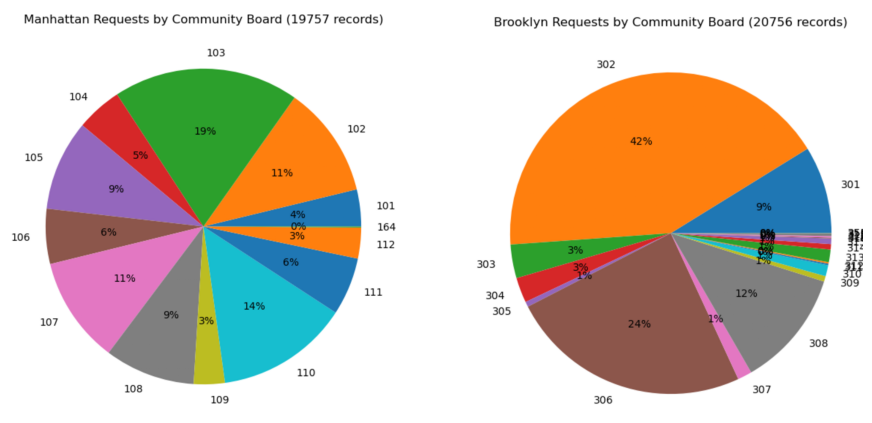

In [2]:
SideImage('Screenshots/F2Man.png','Screenshots/F3Brook.png')

* For Queens, service requests are distributed more evenly. CB3 has the most requests (19%) followed by CB10 (14%).
* For Bronx, CB5 covers 52% of all service requests with the remainder distributed more evenly.

array([<Axes: >, <Axes: >], dtype=object)

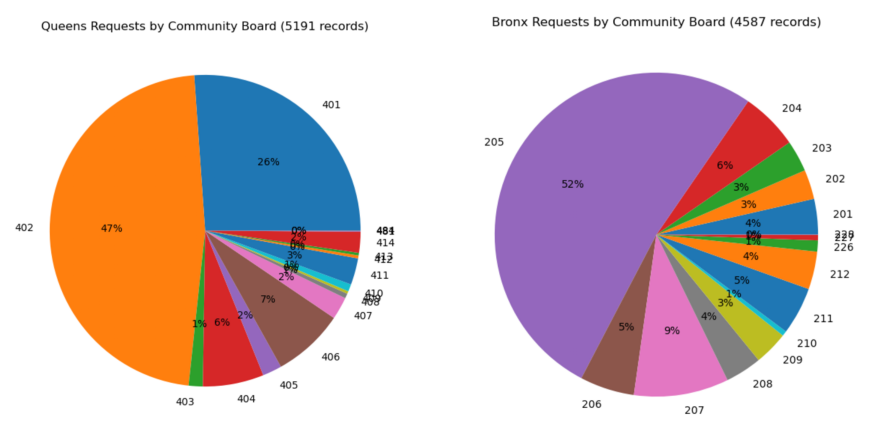

In [3]:
SideImage('Screenshots/F4Queens.png','Screenshots/F5Bronx.png')

## Top Frequent Requested Areas <a name="d4"></a>
* This suggests vigilance of neighbors or cyclists reporting in that area.

![Fig2.1](Screenshots/Top10.png)


## Temporal Analysis <a name="d5"></a>
 
* Compared to previous year, there is less service requests except during the summer months
* There is seasonal variance with a drop during the summer months. I speculate that it could be related to school not being in session, and less vigilance

![Fig2.3](Screenshots/F6Time.png)

* There are nearly twice more service requests during the weekday than the weekend. Wednesday has the most service requests.
* Service requests peak around rush hour times: 8AM, 2PM, and 6PM.

array([<Axes: >, <Axes: >], dtype=object)

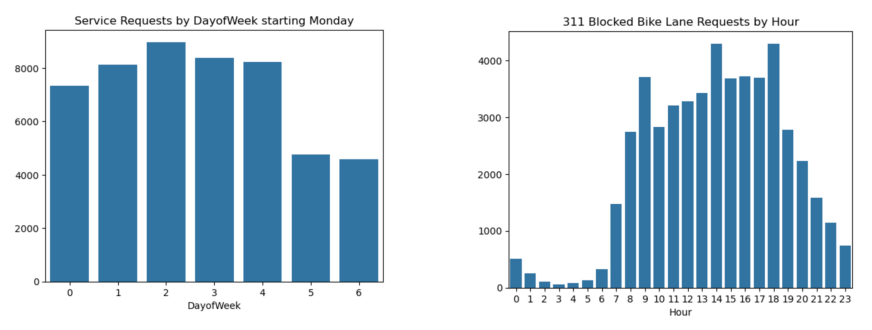

In [4]:
SideImage('Screenshots/F7DayofWeek.png','Screenshots/F8Hour.png')

# NYPD Response Breakdown of Service Requests <a name="d6"></a>

* As explained in the data section, NYPD responses were categorized into [Miss, Pass, Action, and Summon]
* About 30% of service requests led to enforcement

![Fig3.1](Screenshots/F9Response.png)

## NYPD Response Breakdown by Borough <a name="d7"></a>

* For Bronx, about 22% of service requests led to enforcement though increased number of summons
* Both Brooklyn and Manhattan follows the average
* For Queens, about 40% of service requests led to enforcement

![Fig4.1](Screenshots/G1Response.png)

# NYPD Response Time Breakdown (Unbinned) <a name="d8"></a>

* Note: Response times considers once the entire interaction with the violator is completed. If the violator is present, the response time should be longer.

![Fig6.1](Screenshots/F10Elapse.png)

## NYPD Response Time Breakdown (binned) <a name="d9"></a>

* Nearly 2/3 of all service requests are resolved within 1 hour.
* At the extremes, 5% of service requests are resolved within 5 minutes, while 3% of service requests are resolved after 6 hours

![Fig7.1](Screenshots/F11ElapseBin.png)

## NYPD Response Time Breakdown by Borough (binned) <a name="d10"></a>

* For Bronx, 57% of responses took at least over 1 hour with 11% taking over 6 hours.
* For Queens, 42% of response took at least over 1 hour
* Manhattan has the most favorable response times with only 21% of response took at least over 1 hour

![Fig8.1](Screenshots/T1RespBo.png)

## NYPD Response Time Breakdown by Resolution (binned) <a name="d11"></a>

* When summons were given, over 40% of requests were within 1 to 6 hour response time. I predict that it's likely the result of multiple persons filling a service request for the same violator. In addition, the process of writing a summons and discourse with violator can increase response time
* When NYPD took "Action" against the violator, they had faster response times even considering extra time for dialogue.
* When NYPD "Miss" the violators, 40% of the time they investigated at least one hour or longer
* When the NYPD took "No-Action", 7% of service requests were completed in 5 minutes or less. This seems suspicious

![Fig9.1](Screenshots/T2RespRes.png)

# Geo-Spatial Analysis  <a name="d13"></a>


## Community Board Density Map (Interactive) <a name="d14"></a>

* On HOVER: NYPD Respones
* On CLICK: NYPD Response Time

In [37]:
Geo_TotalMap()

## NYPD Blocked Bike Lane Service Response Bubble Map (Interactive) <a name="d15"></a>

* **Note:** The color indicates increased frequency, and the scale was balanced to increase visibility
* **Scale:** Green: 5 or less; Orange: 5 to 25; Purple: 25+
* ON Click: NYPD Response

In [27]:
Bub_CB()

## NYPD Median Response TIME Bubble Map (Interactive) <a name="d16"></a>

* **Legend:** The color indicates median response time. Green: =< 30 mins; Orange: 30 to 60 mins; Red: > 60 mins
* **Scale:** All locations must have at least six entries.
* **ON Click:** Median Response and Response Distribution
* Some areas of Brooklyn, Queens, and Bronx are deeply concerning where there is greater frequency of violations, and slow police response time

In [39]:
Bub_Med()

## 311 Blocked Bike Lane Dashboard <a name="d17"></a>

With the dashboard you can select date range, select community board, and monitor existing police responses. [CLICK HERE for DashBoard](https://sustainabu.shinyapps.io/blockedbikelanedashboard/) 

It also includes a Median response density map with screenshot below [CLICK HERE to view graph](https://public.flourish.studio/visualisation/20685536/)


<div class="flourish-embed flourish-map" data-src="visualisation/20685536"><script src="https://public.flourish.studio/resources/embed.js"></script>
<noscript><img src="https://public.flourish.studio/visualisation/20685536/thumbnail" width="100%" alt="map visualization" /></noscript></div>



# Summary/ Conclusion <a name="d18"></a>

From the data analysis, there is reason for citizens to be concerned about NYPD enforcement of blocked bike lane requests. 
* The NYPD enforces only 30% of service requests.
* For resolutions where NYPD took no action, 7% of requests were responded in 5 minutes or less, varying greatly from the average. This is suspicious.
* When NYPD issues a verifiable summons, only 1% of requests were responded in 5 minutes or less, and often responded later
* When NYPD "misses' the violator, their response time is considerably slower than all actions
* Comparing boroughs, NYPD response time for Manhattan is better across the board. For the Bronx, and Queens, the response times are very slow.
* From the maps, there are hotspots within a neighborhood of sub-par NYPD response that communities can focus on.


 **How do we measure improved progress of NYPD enforcement?**

The most obvious metric is reducing NYPD response time. This goal is easy to achieve if they don't actually review the violation. They can falsely review requests earlier and provide a "No-Action" or "Miss" resolution, to reduce their recorded response time. This coincides with previous investigative reporting. The data corroborates foul behavior by the stark difference of response times where summons (confirmable resolution) were given. 

**Here are three recommendation strategies:**
1) **Administrative:** New administrative leadership prioritizing cutting down poor practices. This could create short-term change, but can revert to the previous state. This is not sustainable.
2) **Geo-validation:** Since traffic violations are location-specific, it could be required for the responding personnel to geo-validate when confirming their investigation. This process assures "ghost" enforcements are not made, but cannot confirm if proper enforcement was taken.
3) **Crowd-Source Validation:** This process involves citizens (i.e. crowd) to verify law enforcement. Citizens would file a 311 request, and enter data independently through an app. From the discrepancy between the 311 request and crowd-source data, citizens can hold local law enforcement accountable. I'm interested in creating a civic-tech app. If you are a developer, biking/ transit advocate, let’s connect. 


# Next Steps/ Opportunities <a name="d19"></a>
* Partner with local community organizations for an intentional campaign to improve biking violation enforcement. You can measure real-time progress with community dashboard
* A dedicated team to build a civic tech app and launch in appropiate community
* Data Request: If anyone has a geo-validation method to link geo-coordinates to NYPD police precincts, this will greatly expand precision, and analysis.
* Contact me: anayeem1@gmail.com

# Run Code <a name="d20"></a>

In [36]:
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings('ignore')
import json
from urllib.request import urlopen
from IPython.display import HTML
from IPython.display import display
import requests # library to handle requests
import folium
import seaborn as sns
from plotly import graph_objects as go
import plotly.express as px
import geopandas
import branca

#Placing Side by side Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from matplotlib import rcParams

%matplotlib inline

def SideImage(Img1, Img2):
    rcParams['figure.figsize'] = 11 ,8
    img_A = mpimg.imread(Img1)
    img_B = mpimg.imread(Img2)

    # display images fig, 
    fig, ax = plt.subplots(1,2)
    ax[0].imshow(img_A)
    ax[0].axis('off') 
    ax[1].imshow(img_B)
    ax[1].axis('off')
    return ax

#regular coding
#1.Read local files 
#dataframe
df = pd.read_csv("dfc_out.csv")
df.cboard=df.cboard.astype(int)
print(df.shape)



#GeOMAPPING
# Open the GeoJSON file and load it into a dictionary
with open('Data_json/communityDistricts.geojson', 'r') as f:
    geojson_data = json.load(f)
    
#prrepare Data
state= geopandas.GeoDataFrame.from_features(geojson_data, crs="EPSG:4326")
d=['geometry','boro_cd']
state= state[d]
state.columns=['geometry','cboard']
state['cboard'] = state['cboard'].astype(str)

def Geo_TotalMap(Var1='All'):
    if Var1=='All':
        dfc=df
    else:
        dfc=df

    #geopanda item
    state1= state
    NYC_map = folium.Map(location=[40.7128466, -73.9138168], zoom_start=11, tiles="OpenStreetMap")
    
    # Get Total by Community Board
    p=['cboard','index_']
    df1=dfc[p].groupby(['cboard']).sum().reset_index()
    df1.columns=['cboard','total']
    df1.cboard=df1.cboard.astype(str)
    A=pd.merge(state, df1, on='cboard', how='right') 
    
    # Get Total by TimeElapse
    p2=['cboard','ElapsedMinuteBin','index_']
    pv=dfc[p2].groupby(['cboard','ElapsedMinuteBin']).sum().reset_index()
    pv2=pd.pivot_table(pv,index='cboard', columns='ElapsedMinuteBin', values=['index_']).reset_index().fillna(0)
    #CHECK ORDER OF COLUMNS - Alphabetical
    pv2.columns=['cboard',"min0->5", "min30->60", "min360+", "min5->30","min60->360"] 
    pv2.cboard=pv2.cboard.astype(str)
    B= pd.merge(A, pv2, on='cboard', how='right') 
    
    # Get Total by Resolution
    p2=['cboard','resolution','index_']
    pv=dfc[p2].groupby(['cboard','resolution']).sum().reset_index()
    pv2=pd.pivot_table(pv,index='cboard', columns='resolution', values=['index_']).reset_index().fillna(0)
    #CHECK ORDER OF COLUMNS - Alphabetical
    pv2.columns= ['cboard','Action','Miss','No-Action','Summon']
    pv2.cboard=pv2.cboard.astype(str)
    geomerge= pd.merge(B, pv2, on='cboard', how='right') 

    #Creates colored map, legend, and color scheme
    colormap = branca.colormap.LinearColormap(
        vmin=geomerge["total"].quantile(0.0),
        vmax=geomerge["total"].quantile(1),
        colors=["white", "pink", "orange", "red", "darkred"],
        caption="Service Requests",
    )
    #When clicked
    popup = folium.GeoJsonPopup(
        fields=['cboard',"total","min0->5", "min5->30", "min30->60", "min60->360", "min360+"],
        localize=True,
        labels=True,
        style="background-color: yellow;",
    )
    #when hover on
    tooltip = folium.GeoJsonTooltip(
        fields=['cboard',"total",'Miss','No-Action','Action','Summon'],
        localize=True,
        sticky=False,
        labels=True,
        style="""
            background-color: #F0EFEF;
            border: 1px solid black;
            border-radius: 1px;
            box-shadow: 1px;
        """,
        max_width=800,
    ) 
    #data
    g = folium.GeoJson(
        geomerge,
        style_function=lambda x: {
            "fillColor": colormap(x["properties"]["total"])
            if x["properties"]["total"] is not None
            else "transparent",
            "color": "black",
            "weight":1.5, #set thickness
            "fillOpacity": 0.7,
        },
        tooltip=tooltip,
        popup=popup,
    ).add_to(NYC_map)
    colormap.add_to(NYC_map)

    # Add a title to the map
    title_html = f"""
         <h3 align="center" style="font-size:16px"><b>NYC Blocked Bike Lane Service Requests Map since 2023 by Communnity Board (Interactive)</b></h3>
         """
    NYC_map.get_root().html.add_child(folium.Element(title_html))

    source_html = f"""
         <div style="
            position: fixed; 
            bottom: 5px; 
            left: 12%; 
            transform: translateX(-50%);
            z-index: 1000;
            font-size: 18px; 
            font-weight: bold;
            background-color: #D3D3D3; 
            padding: 5px 10px; 
            border-radius: 5px; 
            box-shadow: 0 2px 5px rgba(0, 0, 0, 0.5);">
            Source: <a href="https://data.cityofnewyork.us/Social-Services/311-Service-Requests-from-2010-to-Present/erm2-nwe9/about_data/" target="_blank">311 Service Requests</a>
         </div>
         """
    NYC_map.get_root().html.add_child(folium.Element(source_html))    
    return NYC_map


def Bub_CB(CB="All"):
    if CB=="All":
        B=df 
        zo= 11.25
        default_location = [40.7128, -74.0060]
    else: 
        B= df[(df['cboard'] == CB)]
        zo=13   

    data = [[101, [40.690187,-74.043877]],[102, [40.742496, -74.00915]],[103, [40.733965, -73.9887793]],[104, [40.7731795, -73.993936]],[105, [40.7642788,-73.97301]],[106, [40.7301590,-73.961284]],[107, [40.8011564, -73.959646]],
            [108, [40.76904, -73.9418003]],[109, [40.8303719, -73.94014]],[110, [40.8359809, -73.9344523]],[111, [40.8008521, -73.92133752]],[112, [40.8359809, -73.9344523]],[164, [40.79687199, -73.9492332]],
            [201, [40.8204754, -73.901292]],[202, [40.795808,-73.8968088]],[203, [40.837521, -73.880720]],[204, [40.844581,-73.902688]],[205, [40.8617,-73.89138]],[206, [40.84376077,-73.8718461]],[207, [40.8715757, -73.875188]],
            [208, [40.911417, -73.896633]],[209, [40.835619, -73.8397948]],[210, [40.834667,-73.78833349]],[211, [40.86089,-73.828343]],[212, [40.883643,-73.793855]],[227, [40.869674,-73.87053738]],[226,[40.90294,-73.8678979]],[228,[40.86079,-73.773218]],
            [301, [40.7141,73.924059]],[302, [40.70709,-73.96929]],[303, [40.68721,-73.918046]],[304, [40.682336,-73.896466]],[305, [40.69473, -73.8684]],[306, [40.6924,-74.001743]],[307, [40.661154, -73.98017]],
            [308, [40.67983,-73.95829]],[309, [40.66449,-73.928722]],[310, [40.644039,-74.03231]],[311, [40.6088,-73.972994]],[312, [40.648257,-73.9713963]],[313, [40.5958,-73.98372]],[314, [40.655048,-73.9563]],[315, [40.58657,-73.918]],[316, [40.678898,-73.90349]],
            [317,[40.65118,-73.907552]],[318,[40.586269,-73.915133]],[356, [40.584526,-73.9123679]],[355,[40.671622,-73.962571]],
            [401, [40.79018,-73.90647]],[402, [40.75424,-73.8979]],[403, [40.76667,-73.86272]],[404, [40.739,-73.8475]],[405, [40.73429,-73.8877]],[406, [40.7154,-73.826]],[407, [40.76,-73.85249]],
            [408, [40.726229,-73.7567]],[409, [40.704,-73.8170973]],[410, [40.650278,-73.857223]],[411, [40.778947,-73.7446137]],[412, [40.66632,-73.8016826]],[413,[40.637529,-73.7469432]],[414,[40.565287,-73.9097168]],
            [480, [40.76667,-73.86272]],[481, [40.74343,-73.835915]],[482, [40.7114646,-73.8357]],[483, [40.637554,-73.7469397]],[484, [40.557676,-73.932222]],
            [501, [40.641448,-74.159456]],[502, [40.57838,-74.073466]],[503, [40.536306,-74.1331958]],[595, [40.566422,-74.050508]]]
    
    # Create the pandas DataFrame 
    Loc = pd.DataFrame(data, columns = ['Community', 'Location']) 
    #Loc.iloc[ComNum,1:]    

    # Use default location for "All"
    if CB == "All":
        map_location = default_location
    else:
        map_location = Loc.loc[Loc['Community'] == CB, 'Location'].iloc[0]
    
    # generate a new map
    FG_map = folium.Map(location=map_location, zoom_start=zo,tiles="CartoDB positron") #tiles="OpenStreetMap")
    
    Index =['incident_address','longitude','latitude', "index_",'Miss','No-Action','Action','Summon']
    B17=B[Index].groupby(['incident_address','longitude','latitude']).sum().reset_index()
    # Less than 5 count
    BA=B17.query('index_<=5')
    for index, row in BA.iterrows(): 
        popup_text = "Address: {}<br> Total: {}<br> Miss: {}<br> No-Action: {}<br> Action: {}<br> Summons: {}"
        popup_text = popup_text.format(row['incident_address'],row['index_'], row["Miss"],row['No-Action'], row['Action'], row['Summon'])
        folium.CircleMarker(location=(row["latitude"],row["longitude"]),
                            radius=row['index_'] +2,
                            color="#007849",
                            popup=popup_text,
                            fill=True).add_to(FG_map)
    # Between 5 and 25 count
    BB=B17.query('index_<=25 and index_>5')   
    for index, row in BB.iterrows(): 
        popup_text = "Address: {}<br> Total: {}<br> Miss: {}<br> No-Action: {}<br> Action: {}<br> Summons: {}"
        popup_text = popup_text.format(row['incident_address'],row['index_'], row["Miss"],row['No-Action'], row['Action'], row['Summon'])
        folium.CircleMarker(location=(row["latitude"],row["longitude"]),
                            radius=row['index_']/5 +7,
                            color="#E37222",
                            popup=popup_text,
                            fill=True).add_to(FG_map)
    # Greater than 25 count
    BC=B17.query('index_>25')
    for index, row in BC.iterrows(): 
        popup_text = "Address: {}<br> Total: {}<br> Miss: {}<br> No-Action: {}<br> Action: {}<br> Summons: {}"
        popup_text = popup_text.format(row['incident_address'],row['index_'], row["Miss"],row['No-Action'], row['Action'], row['Summon'])
        folium.CircleMarker(location=(row["latitude"],row["longitude"]),
                            radius=row['index_']/15 +12,
                            color="#800080",
                            popup=popup_text,
                            fill=True).add_to(FG_map)        

    title_html = f"""
         <div style="
            position: fixed; 
            top: 5px; 
            left: 50%; 
            transform: translateX(-50%);
            z-index: 1000;
            font-size: 18px; 
            font-weight: bold;
            background-color: yellow; 
            padding: 5px 10px; 
            border-radius: 5px; 
            box-shadow: 0 2px 5px rgba(0, 0, 0, 0.5);">
            Blocked Bike Lane Service Requests (Interactive)
         </div>
         """
    FG_map.get_root().html.add_child(folium.Element(title_html))

    source_html = f"""
         <div style="
            position: fixed; 
            bottom: 5px; 
            left: 12%; 
            transform: translateX(-50%);
            z-index: 1000;
            font-size: 18px; 
            font-weight: bold;
            background-color: #D3D3D3; 
            padding: 5px 10px; 
            border-radius: 5px; 
            box-shadow: 0 2px 5px rgba(0, 0, 0, 0.5);">
            Source: <a href="https://data.cityofnewyork.us/Social-Services/311-Service-Requests-from-2010-to-Present/erm2-nwe9/about_data/" target="_blank">311 Service Requests</a>
         </div>
         """
    FG_map.get_root().html.add_child(folium.Element(source_html))
    
    return FG_map 



def Bub_Med(CB="All"):
    if CB=="All":
        Z=df 
        zo= 11.25
        default_location = [40.7128, -74.0060]
    else: 
        Z= df[(df['cboard'] == CB)]
        zo=13

    data = [[101, [40.690187,-74.043877]],[102, [40.742496, -74.00915]],[103, [40.733965, -73.9887793]],[104, [40.7731795, -73.993936]],[105, [40.7642788,-73.97301]],[106, [40.7301590,-73.961284]],[107, [40.8011564, -73.959646]],
            [108, [40.76904, -73.9418003]],[109, [40.8303719, -73.94014]],[110, [40.8359809, -73.9344523]],[111, [40.8008521, -73.92133752]],[112, [40.8359809, -73.9344523]],[164, [40.79687199, -73.9492332]],
            [201, [40.8204754, -73.901292]],[202, [40.795808,-73.8968088]],[203, [40.837521, -73.880720]],[204, [40.844581,-73.902688]],[205, [40.8617,-73.89138]],[206, [40.84376077,-73.8718461]],[207, [40.8715757, -73.875188]],
            [208, [40.911417, -73.896633]],[209, [40.835619, -73.8397948]],[210, [40.834667,-73.78833349]],[211, [40.86089,-73.828343]],[212, [40.883643,-73.793855]],[227, [40.869674,-73.87053738]],[226,[40.90294,-73.8678979]],[228,[40.86079,-73.773218]],
            [301, [40.7141,73.924059]],[302, [40.70709,-73.96929]],[303, [40.68721,-73.918046]],[304, [40.682336,-73.896466]],[305, [40.69473, -73.8684]],[306, [40.6924,-74.001743]],[307, [40.661154, -73.98017]],
            [308, [40.67983,-73.95829]],[309, [40.66449,-73.928722]],[310, [40.644039,-74.03231]],[311, [40.6088,-73.972994]],[312, [40.648257,-73.9713963]],[313, [40.5958,-73.98372]],[314, [40.655048,-73.9563]],[315, [40.58657,-73.918]],[316, [40.678898,-73.90349]],
            [317,[40.65118,-73.907552]],[318,[40.586269,-73.915133]],[356, [40.584526,-73.9123679]],[355,[40.671622,-73.962571]],
            [401, [40.79018,-73.90647]],[402, [40.75424,-73.8979]],[403, [40.76667,-73.86272]],[404, [40.739,-73.8475]],[405, [40.73429,-73.8877]],[406, [40.7154,-73.826]],[407, [40.76,-73.85249]],
            [408, [40.726229,-73.7567]],[409, [40.704,-73.8170973]],[410, [40.650278,-73.857223]],[411, [40.778947,-73.7446137]],[412, [40.66632,-73.8016826]],[413,[40.637529,-73.7469432]],[414,[40.565287,-73.9097168]],
            [480, [40.76667,-73.86272]],[481, [40.74343,-73.835915]],[482, [40.7114646,-73.8357]],[483, [40.637554,-73.7469397]],[484, [40.557676,-73.932222]],
            [501, [40.641448,-74.159456]],[502, [40.57838,-74.073466]],[503, [40.536306,-74.1331958]],[595, [40.566422,-74.050508]]]
    
    # Create the pandas DataFrame 
    Loc = pd.DataFrame(data, columns = ['Community', 'Location']) 
    #Loc.iloc[ComNum,1:]    

    # Use default location for "All"
    if CB == "All":
        map_location = default_location
    else:
        map_location = Loc.loc[Loc['Community'] == CB, 'Location'].iloc[0]
    
    # generate a new map
    FG_map = folium.Map(location=map_location, zoom_start=zo,tiles="CartoDB positron") #tiles="OpenStreetMap")

    #Prepare Data
    p=['incident_address','longitude','latitude','index_']
    df1=Z[p].groupby(['incident_address','longitude','latitude']).sum().reset_index()
    #df1.columns=['incident_address','index_']
    # Get Binned Count
    p2=['incident_address','ElapsedMinuteBin','index_']
    pv=Z[p2].groupby(['incident_address','ElapsedMinuteBin']).sum().reset_index()
    pv2=pd.pivot_table(pv,index='incident_address', columns='ElapsedMinuteBin', values=['index_']).reset_index().fillna(0)
    #CHECK ORDER OF COLUMNS
    pv2.columns=['incident_address',"min0->5", "min30->60", "min360+", "min5->30","min60->360"]  
    B= pd.merge(df1, pv2, on='incident_address', how='right') 
    # to get median
    p2=['incident_address','MinutesElapsed']
    C=Z[p2].groupby(['incident_address']).median().reset_index()
    C.columns= ['incident_address','MedianResponse_Minutes']   
    D= pd.merge(B, C, on='incident_address', how='right') 
    B17= D.query('index_>5')

    # Median less than 30
    BA=B17.query('MedianResponse_Minutes<=30')
    for index, row in BA.iterrows(): 
        popup_text = "Address: {}<br> Total: {}<br> MedianResponseMin: {}<br> Min0->5: {}<br> Min5->30: {}<br> Min30->60: {}<br> Min60->360: {}<br> Min360+: {}"
        popup_text = popup_text.format(row['incident_address'],row['index_'],row['MedianResponse_Minutes'], row["min0->5"],row["min5->30"], row["min30->60"], row["min60->360"],row["min360+"])
        folium.CircleMarker(location=(row["latitude"],row["longitude"]),
                            radius=row['index_']/15 +3,
                            color="#007849",
                            popup=popup_text,
                            fill=True).add_to(FG_map)
    # Median between 30 and 60
    BB=B17.query('MedianResponse_Minutes<=60 and MedianResponse_Minutes>30')   
    for index, row in BB.iterrows(): 
        popup_text = "Address: {}<br> Total: {}<br> MedianResponseMin: {}<br> Min0->5: {}<br> Min5->30: {}<br> Min30->60: {}<br> Min60->360: {}<br> Min360+: {}"
        popup_text = popup_text.format(row['incident_address'],row['index_'], row['MedianResponse_Minutes'], row["min0->5"],row["min5->30"], row["min30->60"], row["min60->360"],row["min360+"])
        folium.CircleMarker(location=(row["latitude"],row["longitude"]),
                            radius=row['index_']/15 +3,
                            color="#FFB52E",
                            popup=popup_text,
                            fill=True).add_to(FG_map)
    # Median above 60
    BC=B17.query('MedianResponse_Minutes>60')
    for index, row in BC.iterrows(): 
        popup_text = "Address: {}<br> Total: {}<br> MedianResponseMin: {}<br> Min0->5: {}<br> Min5->30: {}<br> Min30->60: {}<br> Min60->360: {}<br> Min360+: {}"
        popup_text = popup_text.format(row['incident_address'],row['index_'],row['MedianResponse_Minutes'], row["min0->5"],row["min5->30"], row["min30->60"], row["min60->360"],row["min360+"])
        folium.CircleMarker(location=(row["latitude"],row["longitude"]),
                            radius=row['index_']/15 +3,
                            color="#E32227",
                            popup=popup_text,
                            fill=True).add_to(FG_map)  
    
    title_html = f"""
         <div style="
            position: fixed; 
            top: 5px; 
            left: 50%; 
            transform: translateX(-50%);
            z-index: 1000;
            font-size: 18px; 
            font-weight: bold;
            background-color: yellow; 
            padding: 5px 10px; 
            border-radius: 5px; 
            box-shadow: 0 2px 5px rgba(0, 0, 0, 0.5);">
            Blocked Bike Lane Response Time (Interactive)
         </div>
         """
    FG_map.get_root().html.add_child(folium.Element(title_html))

    source_html = f"""
         <div style="
            position: fixed; 
            bottom: 5px; 
            left: 12%; 
            transform: translateX(-50%);
            z-index: 1000;
            font-size: 18px; 
            font-weight: bold;
            background-color: #D3D3D3; 
            padding: 5px 10px; 
            border-radius: 5px; 
            box-shadow: 0 2px 5px rgba(0, 0, 0, 0.5);">
            Source: <a href="https://data.cityofnewyork.us/Social-Services/311-Service-Requests-from-2010-to-Present/erm2-nwe9/about_data/" target="_blank">311 Service Requests</a>
         </div>
         """
    FG_map.get_root().html.add_child(folium.Element(source_html))
    
    return FG_map 


Bub_Med(402) 




(50519, 19)


In [2]:


def Bub_Med(CB="All"):
    if CB=="All":
        Z=df 
        zo= 11.25
        default_location = [40.7128, -74.0060]
    else: 
        Z= df[(df['cboard'] == CB)]
        zo=13

    data = [[101, [40.690187,-74.043877]],[102, [40.742496, -74.00915]],[103, [40.733965, -73.9887793]],[104, [40.7731795, -73.993936]],[105, [40.7642788,-73.97301]],[106, [40.7301590,-73.961284]],[107, [40.8011564, -73.959646]],
            [108, [40.76904, -73.9418003]],[109, [40.8303719, -73.94014]],[110, [40.8359809, -73.9344523]],[111, [40.8008521, -73.92133752]],[112, [40.8359809, -73.9344523]],[164, [40.79687199, -73.9492332]],
            [201, [40.8204754, -73.901292]],[202, [40.795808,-73.8968088]],[203, [40.837521, -73.880720]],[204, [40.844581,-73.902688]],[205, [40.8617,-73.89138]],[206, [40.84376077,-73.8718461]],[207, [40.8715757, -73.875188]],
            [208, [40.911417, -73.896633]],[209, [40.835619, -73.8397948]],[210, [40.834667,-73.78833349]],[211, [40.86089,-73.828343]],[212, [40.883643,-73.793855]],[227, [40.869674,-73.87053738]],[226,[40.90294,-73.8678979]],[228,[40.86079,-73.773218]],
            [301, [40.7141,73.924059]],[302, [40.70709,-73.96929]],[303, [40.68721,-73.918046]],[304, [40.682336,-73.896466]],[305, [40.69473, -73.8684]],[306, [40.6924,-74.001743]],[307, [40.661154, -73.98017]],
            [308, [40.67983,-73.95829]],[309, [40.66449,-73.928722]],[310, [40.644039,-74.03231]],[311, [40.6088,-73.972994]],[312, [40.648257,-73.9713963]],[313, [40.5958,-73.98372]],[314, [40.655048,-73.9563]],[315, [40.58657,-73.918]],[316, [40.678898,-73.90349]],
            [317,[40.65118,-73.907552]],[318,[40.586269,-73.915133]],[356, [40.584526,-73.9123679]],[355,[40.671622,-73.962571]],
            [401, [40.79018,-73.90647]],[402, [40.75424,-73.8979]],[403, [40.76667,-73.86272]],[404, [40.739,-73.8475]],[405, [40.73429,-73.8877]],[406, [40.7154,-73.826]],[407, [40.76,-73.85249]],
            [408, [40.726229,-73.7567]],[409, [40.704,-73.8170973]],[410, [40.650278,-73.857223]],[411, [40.778947,-73.7446137]],[412, [40.66632,-73.8016826]],[413,[40.637529,-73.7469432]],[414,[40.565287,-73.9097168]],
            [480, [40.76667,-73.86272]],[481, [40.74343,-73.835915]],[482, [40.7114646,-73.8357]],[483, [40.637554,-73.7469397]],[484, [40.557676,-73.932222]],
            [501, [40.641448,-74.159456]],[502, [40.57838,-74.073466]],[503, [40.536306,-74.1331958]],[595, [40.566422,-74.050508]]]
    
    # Create the pandas DataFrame 
    Loc = pd.DataFrame(data, columns = ['Community', 'Location']) 
    #Loc.iloc[ComNum,1:]    

    # Use default location for "All"
    if CB == "All":
        map_location = default_location
    else:
        map_location = Loc.loc[Loc['Community'] == CB, 'Location'].iloc[0]
    
    # generate a new map
    FG_map = folium.Map(location=map_location, zoom_start=zo,tiles="CartoDB positron") #tiles="OpenStreetMap")

    #Prepare Data
    p=['incident_address','longitude','latitude','index_']
    df1=Z[p].groupby(['incident_address','longitude','latitude']).sum().reset_index()
    #df1.columns=['incident_address','index_']
    # Get Binned Count
    p2=['incident_address','ElapsedMinuteBin','index_']
    pv=Z[p2].groupby(['incident_address','ElapsedMinuteBin']).sum().reset_index()
    pv2=pd.pivot_table(pv,index='incident_address', columns='ElapsedMinuteBin', values=['index_']).reset_index().fillna(0)
    #CHECK ORDER OF COLUMNS
    pv2.columns=['incident_address',"min0->5", "min30->60", "min360+", "min5->30","min60->360"]  
    B= pd.merge(df1, pv2, on='incident_address', how='right') 
    # to get median
    p2=['incident_address','MinutesElapsed']
    C=Z[p2].groupby(['incident_address']).median().reset_index()
    C.columns= ['incident_address','MedianResponse_Minutes']   
    D= pd.merge(B, C, on='incident_address', how='right') 
    B17= D.query('index_>5')

    # Median less than 30
    BA=B17.query('MedianResponse_Minutes<=30')
    for index, row in BA.iterrows(): 
        popup_text = "Address: {}<br> Total: {}<br> MedianResponseMin: {}<br> Min0->5: {}<br> Min5->30: {}<br> Min30->60: {}<br> Min60->360: {}<br> Min360+: {}"
        popup_text = popup_text.format(row['incident_address'],row['index_'],row['MedianResponse_Minutes'], row["min0->5"],row["min5->30"], row["min30->60"], row["min60->360"],row["min360+"])
        folium.CircleMarker(location=(row["latitude"],row["longitude"]),
                            radius=row['index_']/15 +3,
                            color="#007849",
                            popup=popup_text,
                            fill=True).add_to(FG_map)
    # Median between 30 and 60
    BB=B17.query('MedianResponse_Minutes<=60 and MedianResponse_Minutes>30')   
    for index, row in BB.iterrows(): 
        popup_text = "Address: {}<br> Total: {}<br> MedianResponseMin: {}<br> Min0->5: {}<br> Min5->30: {}<br> Min30->60: {}<br> Min60->360: {}<br> Min360+: {}"
        popup_text = popup_text.format(row['incident_address'],row['index_'], row['MedianResponse_Minutes'], row["min0->5"],row["min5->30"], row["min30->60"], row["min60->360"],row["min360+"])
        folium.CircleMarker(location=(row["latitude"],row["longitude"]),
                            radius=row['index_']/15 +3,
                            color="#FFB52E",
                            popup=popup_text,
                            fill=True).add_to(FG_map)
    # Median above 60
    BC=B17.query('MedianResponse_Minutes>60')
    for index, row in BC.iterrows(): 
        popup_text = "Address: {}<br> Total: {}<br> MedianResponseMin: {}<br> Min0->5: {}<br> Min5->30: {}<br> Min30->60: {}<br> Min60->360: {}<br> Min360+: {}"
        popup_text = popup_text.format(row['incident_address'],row['index_'],row['MedianResponse_Minutes'], row["min0->5"],row["min5->30"], row["min30->60"], row["min60->360"],row["min360+"])
        folium.CircleMarker(location=(row["latitude"],row["longitude"]),
                            radius=row['index_']/15 +3,
                            color="#E32227",
                            popup=popup_text,
                            fill=True).add_to(FG_map)  
    
    title_html = f"""
         <div style="
            position: fixed; 
            top: 5px; 
            left: 50%; 
            transform: translateX(-50%);
            z-index: 1000;
            font-size: 18px; 
            font-weight: bold;
            background-color: yellow; 
            padding: 5px 10px; 
            border-radius: 5px; 
            box-shadow: 0 2px 5px rgba(0, 0, 0, 0.5);">
            Blocked Bike Lane Response Time (Interactive)
         </div>
         """
    FG_map.get_root().html.add_child(folium.Element(title_html))

    source_html = f"""
         <div style="
            position: fixed; 
            bottom: 5px; 
            left: 12%; 
            transform: translateX(-50%);
            z-index: 1000;
            font-size: 18px; 
            font-weight: bold;
            background-color: #D3D3D3; 
            padding: 5px 10px; 
            border-radius: 5px; 
            box-shadow: 0 2px 5px rgba(0, 0, 0, 0.5);">
            Source: <a href="https://data.cityofnewyork.us/Social-Services/311-Service-Requests-from-2010-to-Present/erm2-nwe9/about_data/" target="_blank">311 Service Requests</a>
         </div>
         """
    FG_map.get_root().html.add_child(folium.Element(source_html))
    
    return FG_map 


Bub_Med(402) 

In [11]:
p=['community_board','borough','cboard','index_']
dfb=df[p].groupby(['community_board','borough','cboard']).sum().reset_index()
dfb.query('index_>50').sort_values(by='cboard')

["01 MANHATTAN", "02 MANHATTAN", "03 MANHATTAN", "04 MANHATTAN", "05 MANHATTAN", "06 MANHATTAN", "07 MANHATTAN", "08 MANHATTAN", "09 MANHATTAN", "10 MANHATTAN", "11 MANHATTAN", "12 MANHATTAN", "01 BRONX", "02 BRONX", "03 BRONX", "04 BRONX", "05 BRONX", "06 BRONX", "07 BRONX", "08 BRONX", "09 BRONX", "11 BRONX", "12 BRONX", "26 BRONX", "01 BROOKLYN", "02 BROOKLYN", "03 BROOKLYN", "04 BROOKLYN", "05 BROOKLYN", "06 BROOKLYN", "07 BROOKLYN", "08 BROOKLYN", "09 BROOKLYN", "10 BROOKLYN", "13 BROOKLYN", "14 BROOKLYN", "15 BROOKLYN", "18 BROOKLYN", "01 QUEENS", "02 QUEENS", "03 QUEENS", "04 QUEENS", "05 QUEENS", "06 QUEENS", "07 QUEENS", "11 QUEENS", "12 QUEENS", "14 QUEENS"]

,community_board,borough,cboard,index_
2,01 MANHATTAN,Manhattan,101,750
7,02 MANHATTAN,Manhattan,102,2260
12,03 MANHATTAN,Manhattan,103,3765
17,04 MANHATTAN,Manhattan,104,931
21,05 MANHATTAN,Manhattan,105,1832
25,06 MANHATTAN,Manhattan,106,1118
29,07 MANHATTAN,Manhattan,107,2157
34,08 MANHATTAN,Manhattan,108,1828
38,09 MANHATTAN,Manhattan,109,632
42,10 MANHATTAN,Manhattan,110,2694


In [20]:
#A=df
#A.dateTimeO=pd.to_datetime(A['dateTimeO'], format='%Y-%m-%d')
#df.dateTimeO = df.dateTimeO.dt.date
df.dtypes

dateTimeO            object
resolution           object
community_board      object
index_                int64
incident_address     object
latitude            float64
longitude           float64
Action                int64
Miss                  int64
No-Action             int64
Summon                int64
cboard                int32
ElapsedMinuteBin     object
MinutesElapsed      float64
Month                 int64
Year                  int64
borough              object
dtype: object

In [21]:
df.MinutesElapsed.median()

39.57

In [23]:
p2=['resolution','index_']
df[p2].groupby(['resolution']).sum().reset_index()

,resolution,index_
0,Action,12946
1,Miss,15975
2,No-Action,20125
3,Summon,1411


In [24]:
df.iloc[0, 11]

109

In [31]:
p2=['cboard']
df[p2].iloc[0,0]

109

In [29]:
df

,dateTimeO,resolution,community_board,index_,incident_address,latitude,longitude,Action,Miss,No-Action,Summon,cboard,ElapsedMinuteBin,MinutesElapsed,Month,Year,borough
0,2024-12-06 00:16:41,Action,09 MANHATTAN,1,717 ST NICHOLAS AVENUE,40.824523,-73.944415,1,0,0,0,109,min60->360,75.67,12,2024,Manhattan
1,2024-12-05 23:34:18,Miss,02 MANHATTAN,1,237 BLEECKER STREET,40.730535,-74.002580,0,1,0,0,102,min30->60,32.52,12,2024,Manhattan
2,2024-12-05 23:22:51,No-Action,06 MANHATTAN,1,865 1 AVENUE,40.752905,-73.966874,0,0,1,0,106,min5->30,5.75,12,2024,Manhattan
3,2024-12-05 23:21:31,No-Action,06 MANHATTAN,1,845 1 AVENUE,40.752079,-73.967470,0,0,1,0,106,min5->30,5.15,12,2024,Manhattan
4,2024-12-05 23:14:19,No-Action,03 BROOKLYN,1,249 CLASSON AVENUE,40.692667,-73.960781,0,0,1,0,303,min60->360,69.42,12,2024,Brooklyn
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
50452,2023-01-01 16:19:15,No-Action,04 QUEENS,1,99-36 41 AVENUE,40.747970,-73.865263,0,0,1,0,404,min30->60,45.37,1,2023,Queens
50453,2023-01-01 15:52:35,No-Action,08 BROOKLYN,1,340 ST JOHNS PLACE,40.674226,-73.966001,0,0,1,0,308,min60->360,85.25,1,2023,Brooklyn
50454,2023-01-01 13:58:08,Miss,06 BROOKLYN,1,73 BUTLER STREET,40.684057,-73.991855,0,1,0,0,306,min5->30,20.40,1,2023,Brooklyn
50455,2023-01-01 10:26:05,No-Action,08 BROOKLYN,1,538 GRAND AVENUE,40.679591,-73.961729,0,0,1,0,308,min60->360,78.13,1,2023,Brooklyn


In [34]:
data = [[101, [40.690187,-74.043877]],[102, [40.742496, -74.00915]],[103, [40.733965, -73.9887793]],[104, [40.7731795, -73.993936]],[105, [40.7642788,-73.97301]],[106, [40.7301590,-73.961284]],[107, [40.8011564, -73.959646]],
        [108, [40.76904, -73.9418003]],[109, [40.8303719, -73.94014]],[110, [40.8359809, -73.9344523]],[111, [40.8008521, -73.92133752]],[112, [40.8359809, -73.9344523]],[164, [40.79687199, -73.9492332]],
        [201, [40.8204754, -73.901292]],[202, [40.795808,-73.8968088]],[203, [40.837521, -73.880720]],[204, [40.844581,-73.902688]],[205, [40.8617,-73.89138]],[206, [40.84376077,-73.8718461]],[207, [40.8715757, -73.875188]],
        [208, [40.911417, -73.896633]],[209, [40.835619, -73.8397948]],[210, [40.834667,-73.78833349]],[211, [40.86089,-73.828343]],[212, [40.883643,-73.793855]],[227, [40.869674,-73.87053738]],[226,[40.90294,-73.8678979]],[228,[40.86079,-73.773218]],
        [301, [40.7141,73.924059]],[302, [40.70709,-73.96929]],[303, [40.68721,-73.918046]],[304, [40.682336,-73.896466]],[305, [40.69473, -73.8684]],[306, [40.6924,-74.001743]],[307, [40.661154, -73.98017]],
        [308, [40.67983,-73.95829]],[309, [40.66449,-73.928722]],[310, [40.644039,-74.03231]],[311, [40.6088,-73.972994]],[312, [40.648257,-73.9713963]],[313, [40.5958,-73.98372]],[314, [40.655048,-73.9563]],[315, [40.58657,-73.918]],[316, [40.678898,-73.90349]],
        [317,[40.65118,-73.907552]],[318,[40.586269,-73.915133]],[356, [40.584526,-73.9123679]],[355,[40.671622,-73.962571]],
        [401, [40.79018,-73.90647]],[402, [40.75424,-73.8979]],[403, [40.76667,-73.86272]],[404, [40.739,-73.8475]],[405, [40.73429,-73.8877]],[406, [40.7154,-73.826]],[407, [40.76,-73.85249]],
        [408, [40.726229,-73.7567]],[409, [40.704,-73.8170973]],[410, [40.650278,-73.857223]],[411, [40.778947,-73.7446137]],[412, [40.66632,-73.8016826]],[413,[40.637529,-73.7469432]],[414,[40.565287,-73.9097168]],
        [480, [40.76667,-73.86272]],[481, [40.74343,-73.835915]],[482, [40.7114646,-73.8357]],[483, [40.637554,-73.7469397]],[484, [40.557676,-73.932222]],
        [501, [40.641448,-74.159456]],[502, [40.57838,-74.073466]],[503, [40.536306,-74.1331958]],[595, [40.566422,-74.050508]]]

# Create the pandas DataFrame 
Loc = pd.DataFrame(data, columns = ['Community', 'Location'])


p2=['cboard']
df[p2].iloc[0,0]
Loc.loc[Loc['Community'] == df[p2].iloc[0,0], 'Location'].iloc[0]
df.dtypes

dateTimeO            object
resolution           object
community_board      object
index_                int64
incident_address     object
latitude            float64
longitude           float64
Action                int64
Miss                  int64
No-Action             int64
Summon                int64
cboard                int32
ElapsedMinuteBin     object
MinutesElapsed      float64
Month                 int64
Year                  int64
borough              object
dtype: object